---

# An Analysis Taylor Swift's *Reputation* Album

**Rick Liu**

<div>
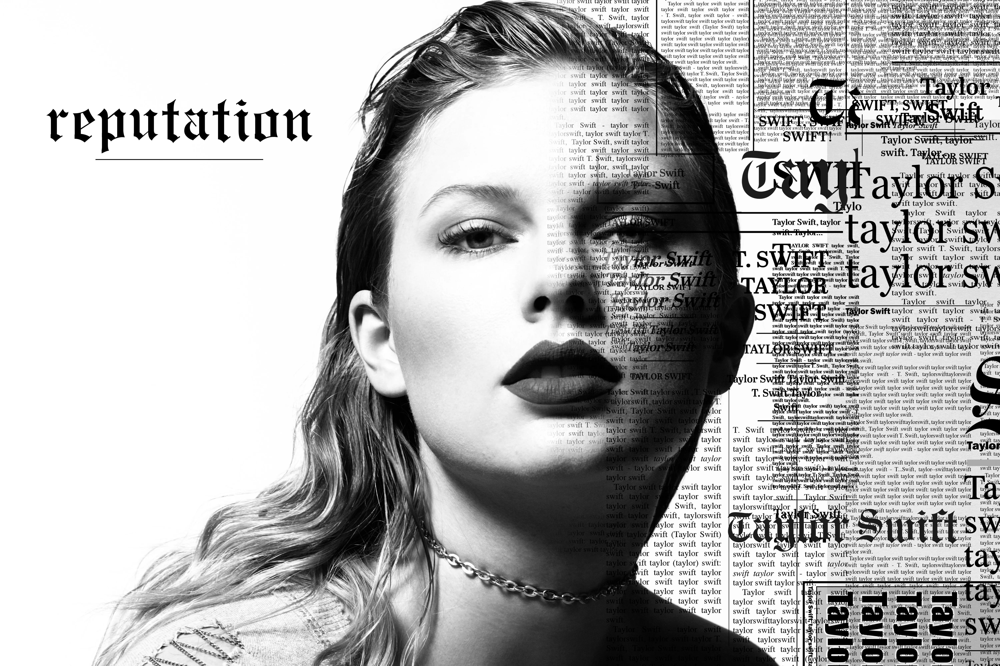
</div>

---

## Introduction 

#### Description of Data
Two datasets were used. One to draw the lyrics of Taylor Swift's songs while the other draws from Spotify to obtain the popularity.

#### Link to Data Source

Both datasets were drawn from Kaggle. 

- Lyrics Data : https://www.kaggle.com/datasets/thespacefreak/taylor-swift-song-lyrics-all-albums
- Spotify Data: https://www.kaggle.com/datasets/jarredpriester/taylor-swift-spotify-dataset


#### Motivation

Taylor Swift's reputation album has a special place in my heart becasue. ...

#### Questions

1. How does Taylor Swift engage with listener's emotions through her ordering of songs in *Reputation*?
2. How does the lyrics influence the emotions?
3. How is the popularity of a song related to these emotions?

# Methodology
## Data Cleaning

In [2]:
import pandas as pd

In [3]:
rep = pd.read_csv('06-reputation.csv')
rep.head(5)

,album_name,track_title,track_n,lyric,line
0,reputation,...Ready for It?,1,Knew he was a killer first time that I saw him,1
1,reputation,...Ready for It?,1,Wondered how many girls he had loved and left ...,2
2,reputation,...Ready for It?,1,"But if he's a ghost, then I can be a phantom",3
3,reputation,...Ready for It?,1,"Holdin' him for ransom, some",4
4,reputation,...Ready for It?,1,"Some boys are tryin' too hard, he don't try at...",5


In [4]:
import re

In [5]:
import warnings
warnings.filterwarnings('ignore')

for i in range(len(rep['lyric'])):
    copy = rep['lyric'][i]
    lyrics = copy
    
    lyrics = re.sub(r'[^\x00-\x7F]+'," ", lyrics)
    lyrics = lyrics.replace("(","")
    lyrics = lyrics.replace(")","")
    lyrics = lyrics.replace(",","")
    
    lyrics = lyrics.replace("Joeboy 'Sip (Alcohol)' Official Lyrics & Meaning | Verified","")
    lyrics = lyrics.replace("[Pre-Chorus]","")
    
    lyrics = lyrics.replace("-"," ")
    
    rep['lyric'][i] = lyrics

In [6]:
grp_rep = rep.groupby('track_title')['lyric'].apply(' '.join).reset_index()
grp_rep.head(5)

,track_title,lyric
0,...Ready for It?,Knew he was a killer first time that I saw him...
1,Call It What You Want,My castle crumbled overnight I brought a knife...
2,Dancing with Our Hands Tied,I I loved you in secret First sight yeah we lo...
3,Delicate,This ain't for the best My reputation's never ...
4,Don’t Blame Me,Don't blame me love made me crazy If it doesn'...


In [7]:
for i in range(len(grp_rep['lyric'])):
    copy = grp_rep['lyric'][i]
    lyrics = copy
    
    lyrics = re.sub(r'[^\x00-\x7F]+'," ", lyrics)
    lyrics = lyrics.replace("(","")
    lyrics = lyrics.replace(")","")
    lyrics = lyrics.replace(",","")
    lyrics = lyrics.replace("?","")
    
    lyrics = lyrics.replace("Joeboy 'Sip (Alcohol)' Official Lyrics & Meaning | Verified","")
    lyrics = lyrics.replace("[Pre-Chorus]","")
    
    lyrics = lyrics.replace("-"," ")
        
    grp_rep['lyric'][i] = lyrics

In [8]:
grp_rep['lyric'][13]

"See you in the dark All eyes on you my magician All eyes on us You make everyone disappear and Cut me into pieces Gold cage hostage to my feelings Back against the wall Trippin' trip trippin' when you're gone 'Cause we break down a little But when you get me alone it's so simple 'Cause baby I know what you know We can feel it And all the pieces fall right into place Getting caught up in a moment Lipstick on your face So it goes  I'm yours to keep And I'm yours to lose You know I'm not a bad girl but I Do bad things with you So it goes  Met you in a bar All eyes on me your illusionist All eyes on us I make all your gray days clear And wear you like a necklace I'm so chill but you make me jealous But I got your heart Skippin' skip skippin' when I'm gone 'Cause we break down a little But when I get you alone it's so simple 'Cause baby I know what you know We can feel it And all the pieces fall right into place Getting caught up in a moment Lipstick on your face So it goes  I'm yours to k

# Results

## Exploratory Data Analysis

In [9]:
def counter(s):
    words = len(s.split())
    return words

grp_rep['word_count'] = grp_rep['lyric'].apply(counter)

grp_rep

,track_title,lyric,word_count
0,...Ready for It?,Knew he was a killer first time that I saw him...,459
1,Call It What You Want,My castle crumbled overnight I brought a knife...,521
2,Dancing with Our Hands Tied,I I loved you in secret First sight yeah we lo...,437
3,Delicate,This ain't for the best My reputation's never ...,512
4,Don’t Blame Me,Don't blame me love made me crazy If it doesn'...,479
5,Dress,Our secret moments in a crowded room They got ...,524
6,End Game,I wanna be your end game I wanna be your first...,719
7,Getaway Car,No nothing good starts in a getaway car It was...,567
8,Gorgeous,Gorgeous You should take it as a compliment Th...,438
9,I Did Something Bad,I never trust a narcissist but they love me So...,565


In [10]:
import matplotlib.pyplot as plt

Text(0, 0.5, 'Song Name')

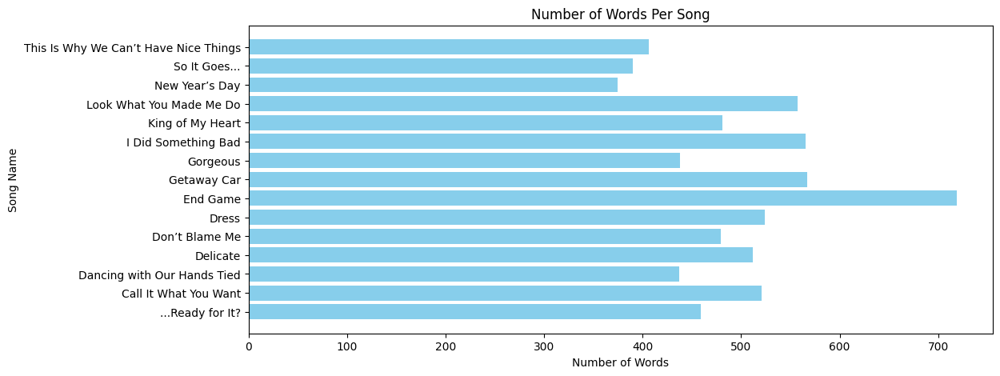

In [11]:
fig, ax = plt.subplots(1, figsize=(12,5))
plt.barh(grp_rep['track_title'], grp_rep['word_count'], color = 'skyblue')

plt.title("Number of Words Per Song")
plt.xlabel("Number of Words")
plt.ylabel("Song Name")

In [12]:
rep['words'] = rep['lyric'].apply(counter)
avg_words = rep.groupby('track_title')['words'].mean().round(1)

grp_rep['avg_words_per_line'] = avg_words.tolist()
grp_rep

,track_title,lyric,word_count,avg_words_per_line
0,...Ready for It?,Knew he was a killer first time that I saw him...,459,7.6
1,Call It What You Want,My castle crumbled overnight I brought a knife...,521,7.0
2,Dancing with Our Hands Tied,I I loved you in secret First sight yeah we lo...,437,6.6
3,Delicate,This ain't for the best My reputation's never ...,512,6.4
4,Don’t Blame Me,Don't blame me love made me crazy If it doesn'...,479,7.6
5,Dress,Our secret moments in a crowded room They got ...,524,7.6
6,End Game,I wanna be your end game I wanna be your first...,719,9.0
7,Getaway Car,No nothing good starts in a getaway car It was...,567,7.6
8,Gorgeous,Gorgeous You should take it as a compliment Th...,438,7.8
9,I Did Something Bad,I never trust a narcissist but they love me So...,565,8.4


Text(0.5, 0, 'Song Name')

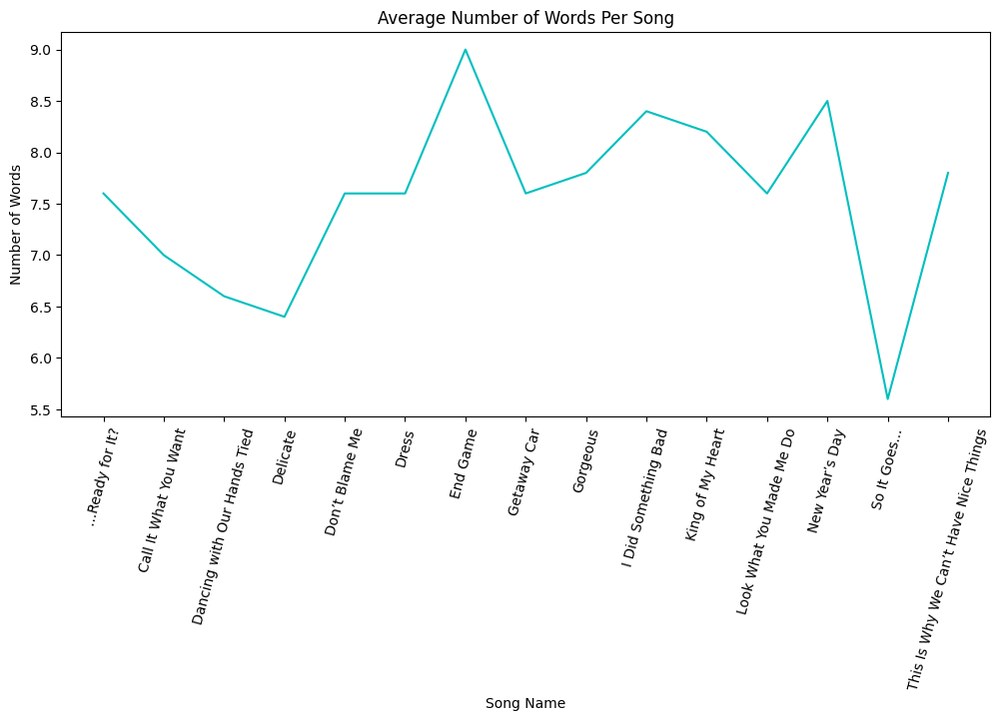

In [13]:
fig, ax = plt.subplots(1, figsize=(12,5))
plt.plot(grp_rep['track_title'], grp_rep['avg_words_per_line'], color = 'c')
plt.xticks(rotation = 75)

plt.title("Average Number of Words Per Song")
plt.ylabel("Number of Words")
plt.xlabel("Song Name")


In [14]:
lines = rep.groupby('track_title')['line'].count()
line_count = lines.tolist()

grp_rep['line_count'] = line_count
grp_rep

,track_title,lyric,word_count,avg_words_per_line,line_count
0,...Ready for It?,Knew he was a killer first time that I saw him...,459,7.6,60
1,Call It What You Want,My castle crumbled overnight I brought a knife...,521,7.0,74
2,Dancing with Our Hands Tied,I I loved you in secret First sight yeah we lo...,437,6.6,66
3,Delicate,This ain't for the best My reputation's never ...,512,6.4,80
4,Don’t Blame Me,Don't blame me love made me crazy If it doesn'...,479,7.6,63
5,Dress,Our secret moments in a crowded room They got ...,524,7.6,69
6,End Game,I wanna be your end game I wanna be your first...,719,9.0,80
7,Getaway Car,No nothing good starts in a getaway car It was...,567,7.6,75
8,Gorgeous,Gorgeous You should take it as a compliment Th...,438,7.8,56
9,I Did Something Bad,I never trust a narcissist but they love me So...,565,8.4,67


In [15]:
import matplotlib.ticker as mticker

Text(0, 0.5, 'Song Name')

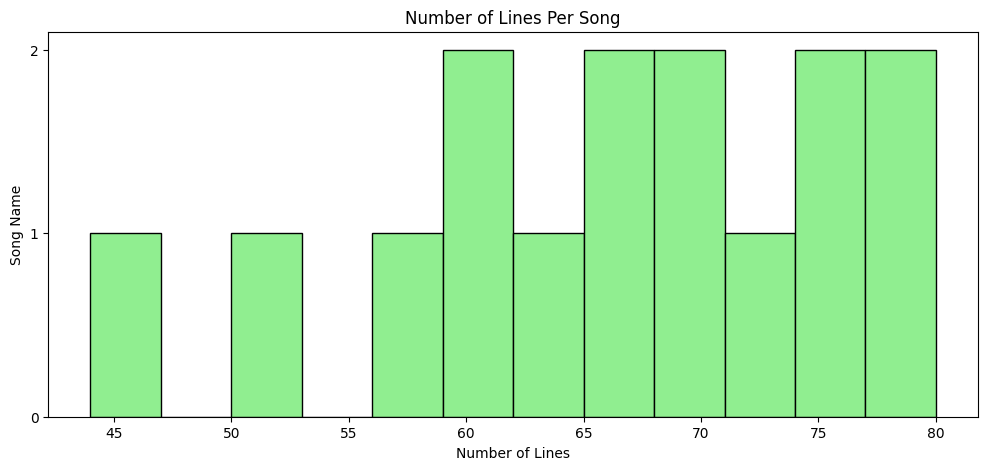

In [16]:
fig, ax = plt.subplots(1, figsize=(12,5))
plt.hist(grp_rep['line_count'], bins = 12, color = 'lightgreen', edgecolor = 'k')

plt.gca().yaxis.set_major_locator(mticker.MultipleLocator(1))

plt.title("Number of Lines Per Song")
plt.xlabel("Number of Lines")
plt.ylabel("Song Name")

In [17]:
grp_rep.sort_values(by=['line_count']).head(2)

,track_title,lyric,word_count,avg_words_per_line,line_count
12,New Year’s Day,There's glitter on the floor after the party G...,375,8.5,44
14,This Is Why We Can’t Have Nice Things,It was so nice throwing big parties Jump into ...,406,7.8,52


In [18]:
grp_rep.sort_values(by=['line_count'], ascending=False).head(2)

,track_title,lyric,word_count,avg_words_per_line,line_count
3,Delicate,This ain't for the best My reputation's never ...,512,6.4,80
6,End Game,I wanna be your end game I wanna be your first...,719,9.0,80


## Data Analysis

- Word Frequnecy
- Sentiment Analysis

In [19]:
import nltk

from nltk.corpus import stopwords
from string import punctuation

from nltk.tokenize import WhitespaceTokenizer

nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /home/jovyan/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /home/jovyan/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [20]:
!pip install contractions

import contractions

In [21]:
fillers = ['ta', 'ooh', 'ah', 'ra', 'di', 'da', 'oh', 'ha']
myStopWords = list(punctuation) + stopwords.words('english') + fillers


tok_lyrics = []

for i in range(len(grp_rep['lyric'])):
    full = grp_rep['lyric'][i]
    expanded = contractions.fix(full)
    
    token = [w for w in WhitespaceTokenizer().tokenize(expanded.lower()) if w not in myStopWords]
    
    tok_lyrics.append(token)

In [22]:
from nltk.probability import FreqDist

In [23]:
freq_dict = {}
for i in range(len(tok_lyrics)):
    freq_dict[i] = FreqDist(tok_lyrics[i])
    
most_used = []
for k in freq_dict.keys():
    most = freq_dict[k].max()
    most_used.append(most)

most_freq = pd.DataFrame({'track': grp_rep['track_title'],
                        'most_freq_word': most_used})
most_freq

,track,most_freq_word
0,...Ready for It?,let
1,Call It What You Want,call
2,Dancing with Our Hands Tied,dancing
3,Delicate,delicate
4,Don’t Blame Me,baby
5,Dress,take
6,End Game,want
7,Getaway Car,getaway
8,Gorgeous,gorgeous
9,I Did Something Bad,good


In [24]:
!pip install wordcloud

from wordcloud import WordCloud

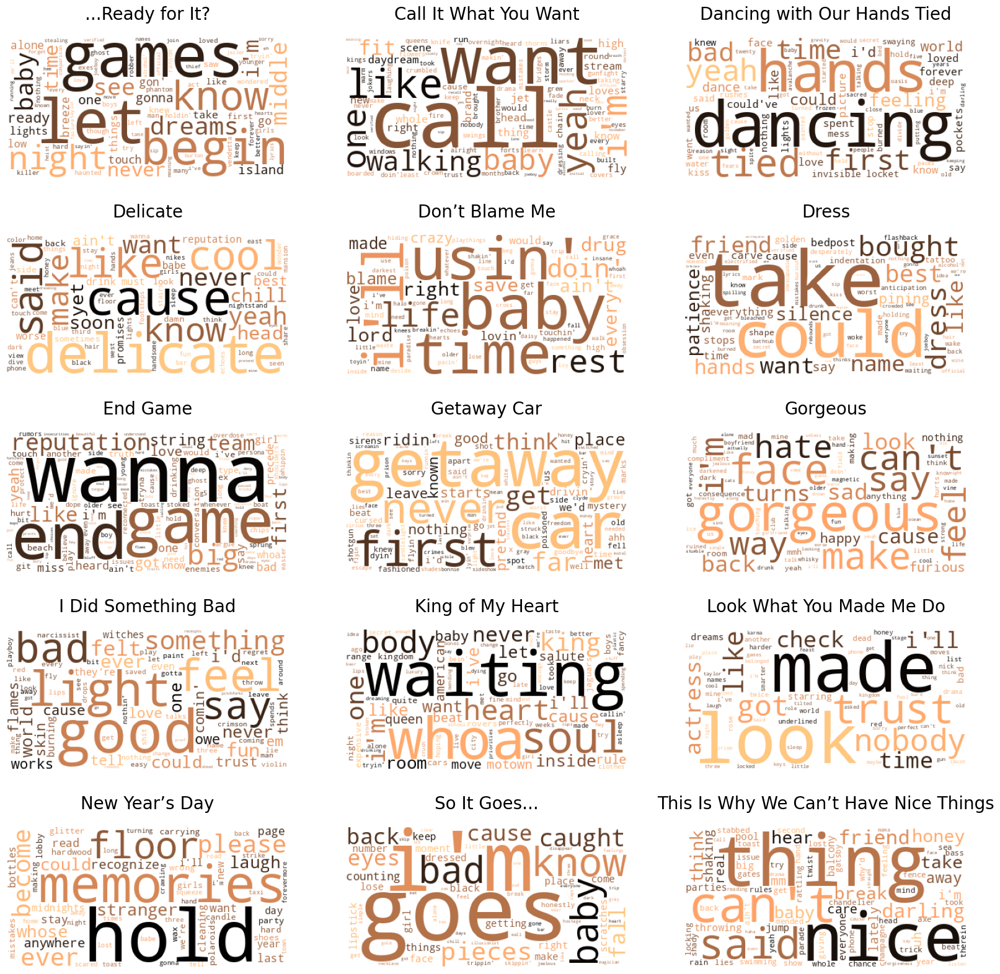

In [25]:
i = 0

fig = plt.figure(figsize=(20,20))

for i in range(len(grp_rep['lyric'])):
    lowered = grp_rep['lyric'][i].lower()
    
    wordcloud = WordCloud(stopwords=myStopWords, background_color="white", 
                          collocations=False, colormap = 'copper').generate(lowered)
    
    ax = fig.add_subplot(5,3,i+1)
    
    ax.set_title(most_freq['track'][i], fontsize=20, pad=20)
    
    ax.imshow(wordcloud)
    ax.axis('off')
    
    i += 1

In [26]:
from nltk.sentiment import vader
from nltk.corpus import opinion_lexicon

nltk.download('vader_lexicon')
nltk.download('opinion_lexicon')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /home/jovyan/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package opinion_lexicon to
[nltk_data]     /home/jovyan/nltk_data...
[nltk_data]   Package opinion_lexicon is already up-to-date!


True

Text(0.5, 1.0, 'Sentiment Scores of Each Track In Reputation Album')

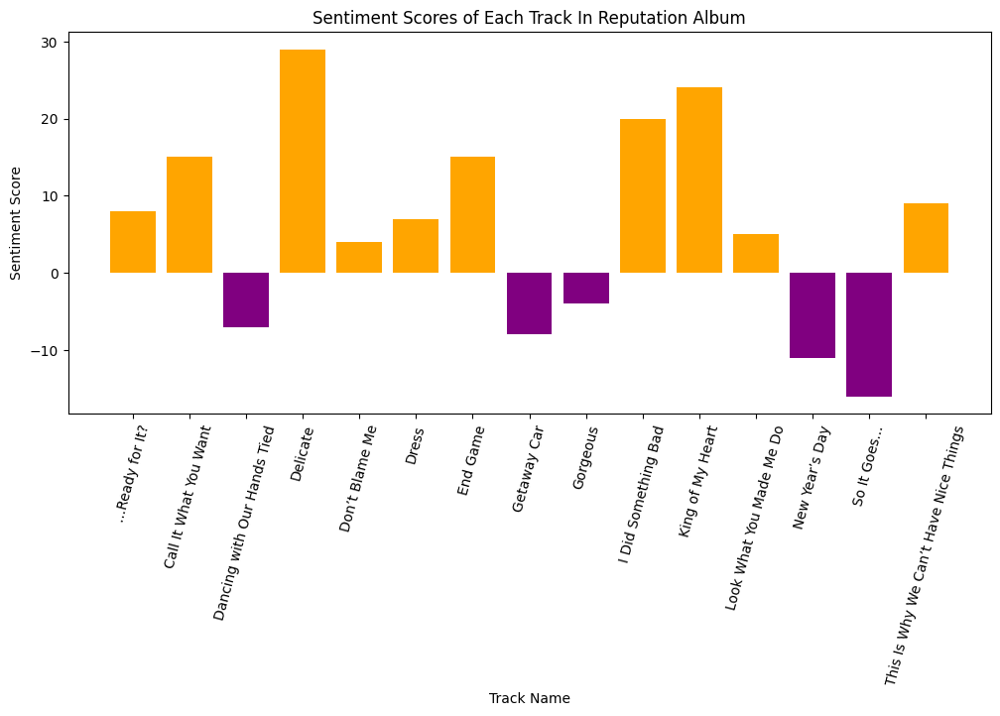

In [27]:
total = []

v = vader.SentimentIntensityAnalyzer()

positive_words = set(opinion_lexicon.positive())
negative_words = set(opinion_lexicon.negative())

for i in range(len(grp_rep['lyric'])):
    com_score = 0
    
    for item in tok_lyrics[i]:        
        if item in positive_words: 
            com_score += 1
        elif item in negative_words:
            com_score -= 1
  
    total.append(com_score)


colors = ['orange' if score >= 0 else 'purple' for score in total]

fig,ax = plt.subplots(figsize=(12, 5))

plt.xticks(rotation = 75)

ax.bar(grp_rep['track_title'], total, color=colors)
ax.set_xlabel('Track Name')
ax.set_ylabel('Sentiment Score')
ax.set_title('Sentiment Scores of Each Track In Reputation Album')

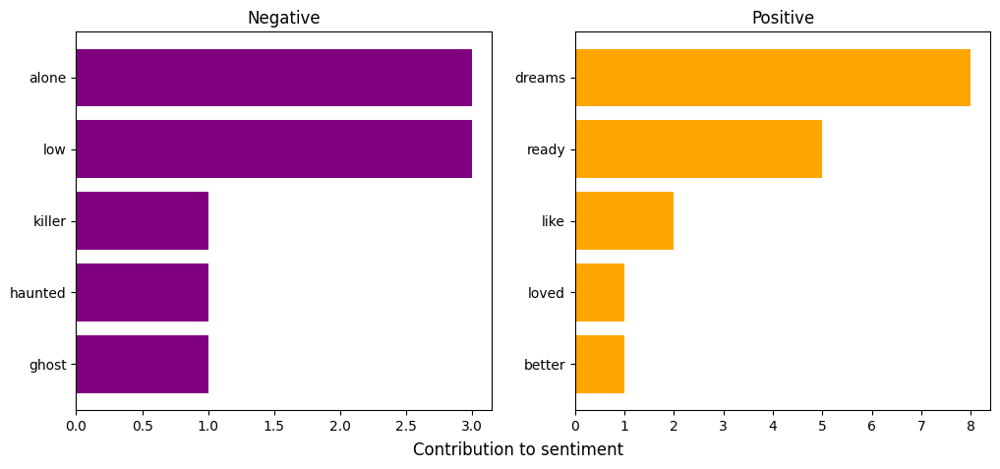

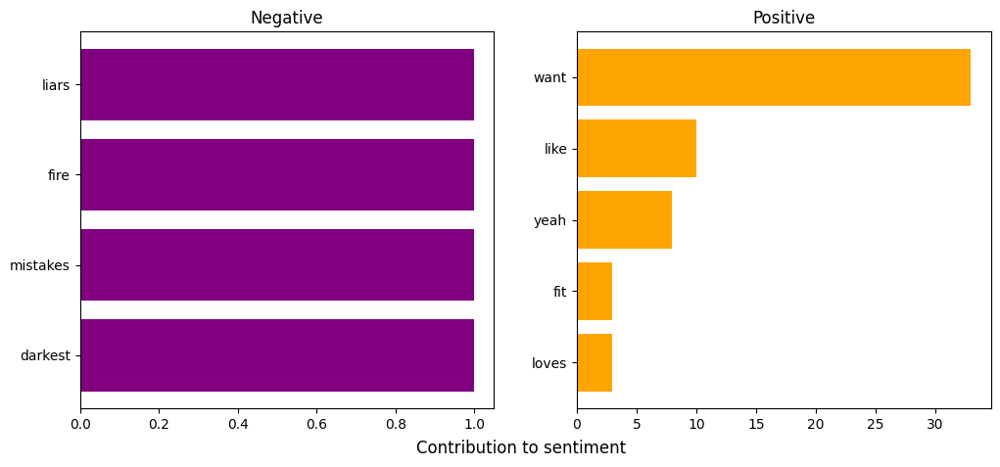

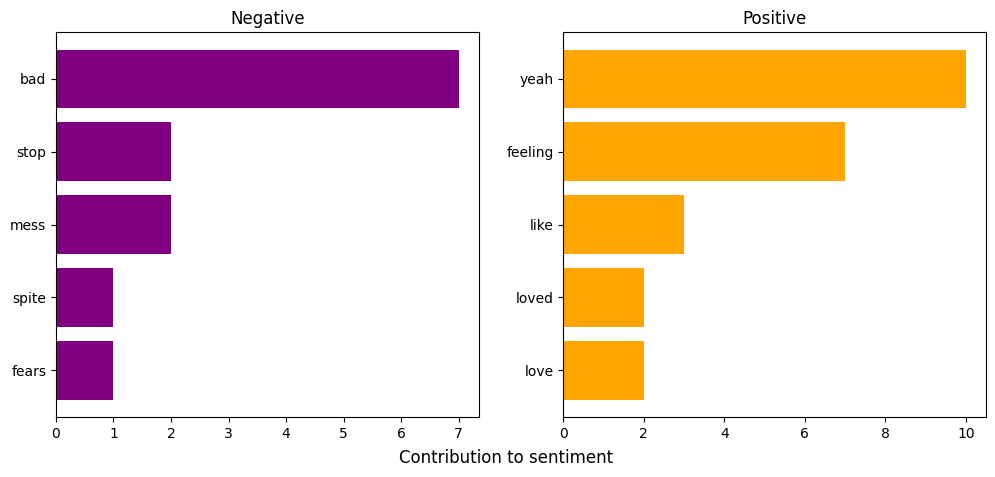

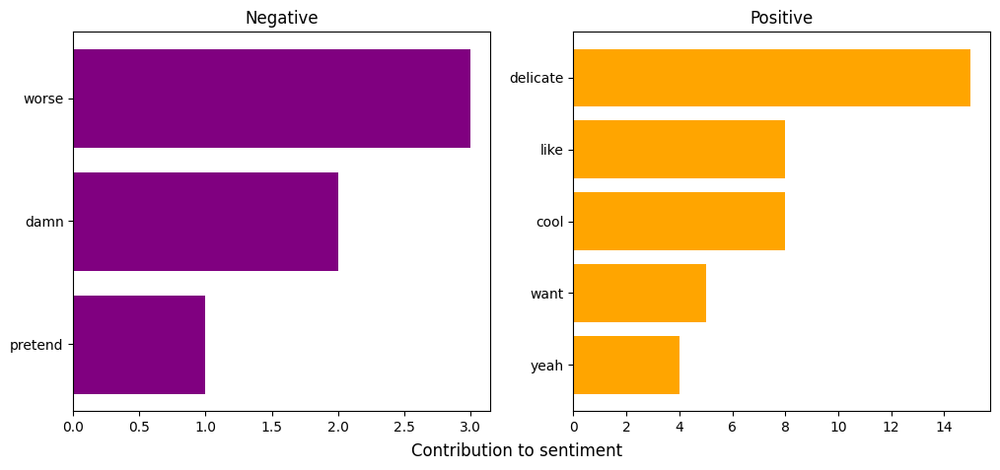

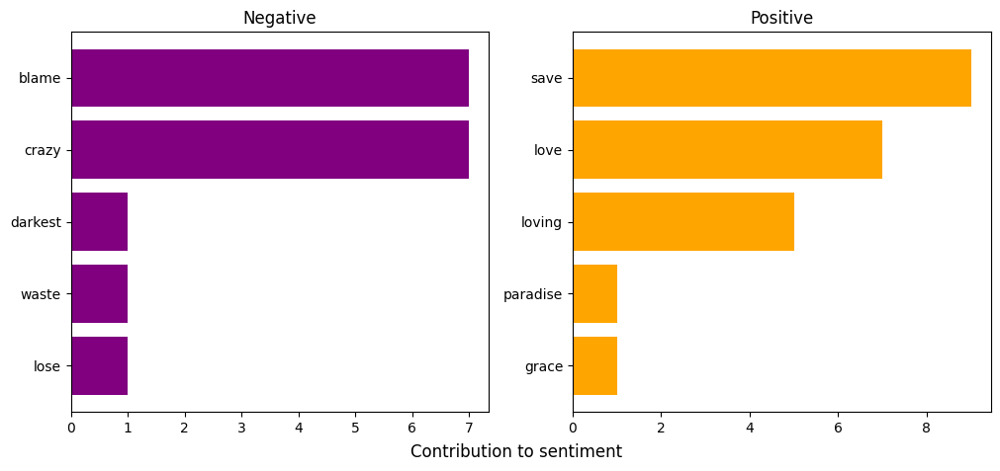

...

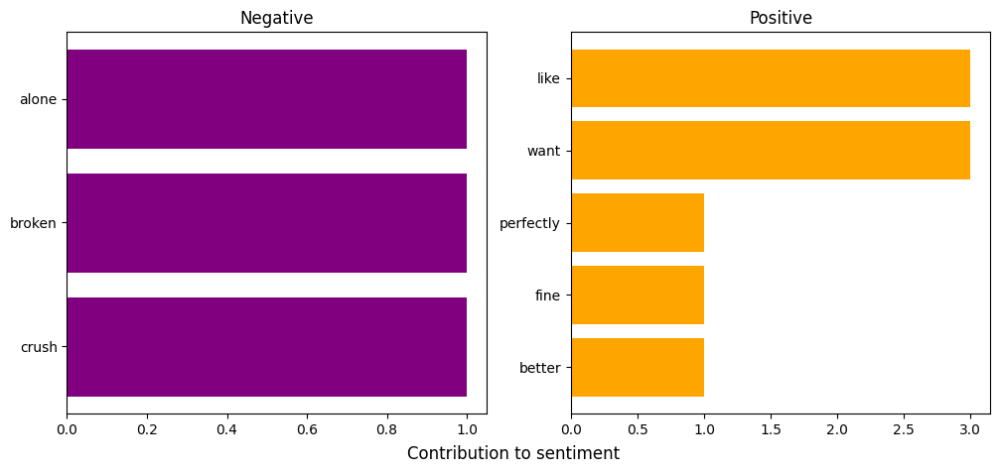

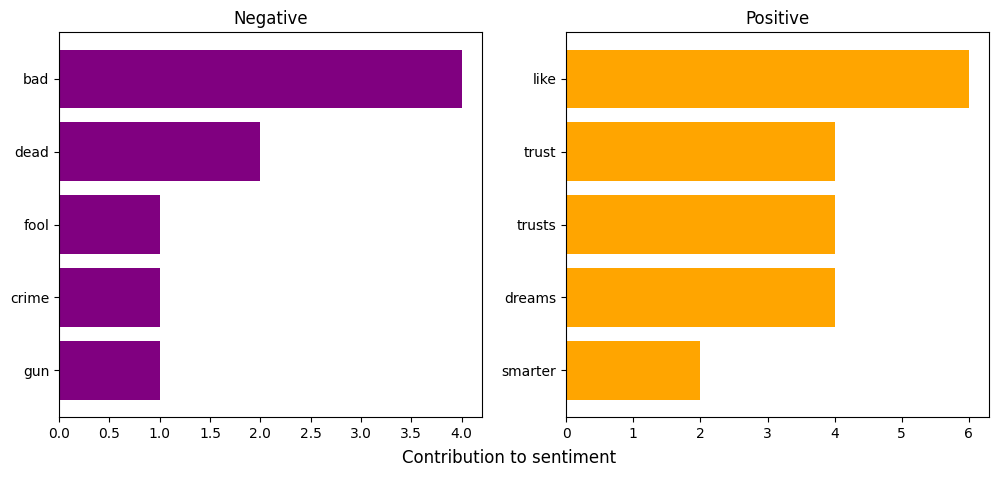

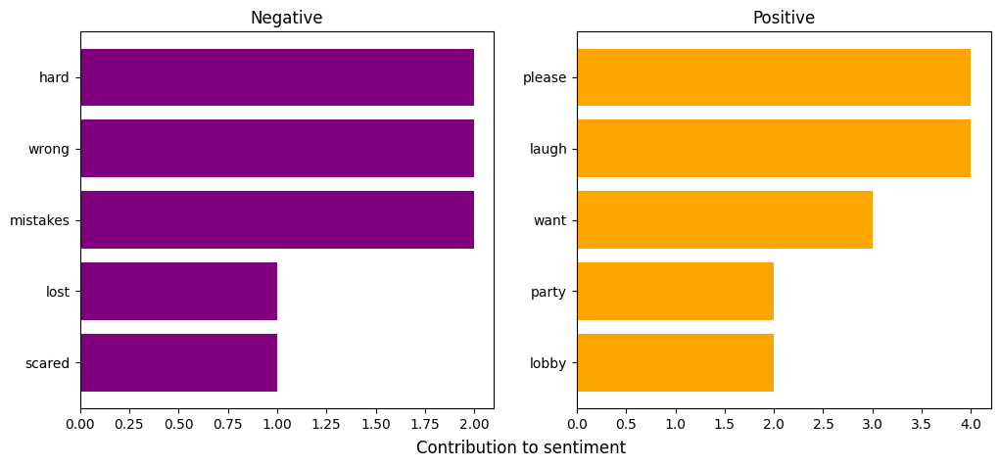

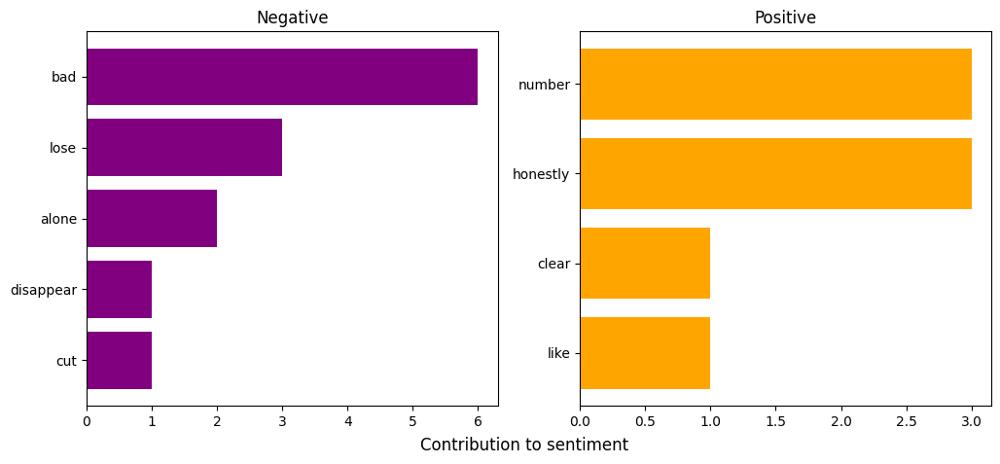

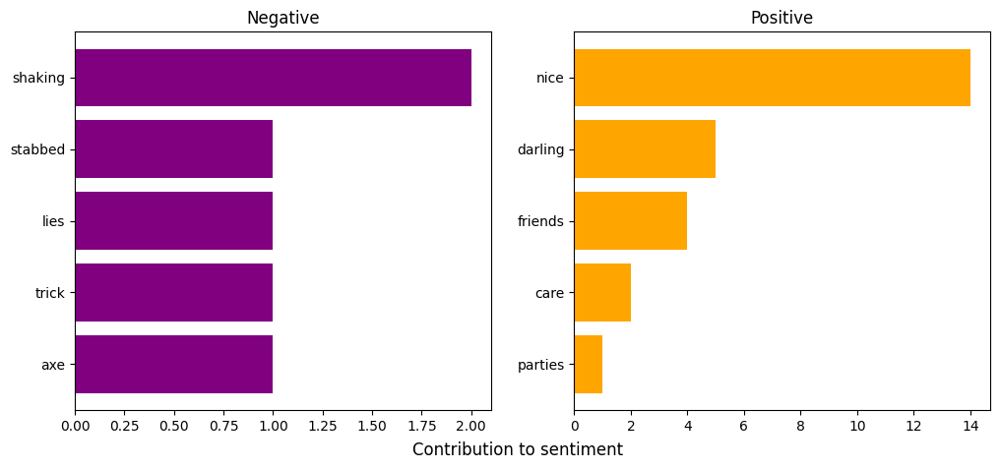

In [28]:
for i in range(len(grp_rep['lyric'])):
    
    pos = []       
    neg = []
    
    for item in tok_lyrics[i]:        
        scores = v.polarity_scores(item)    
        if scores['compound'] > 0:        
            pos.append(item)
        elif scores['compound'] < 0:
            neg.append(item)

    top_pos = nltk.FreqDist(pos).most_common(5)    
    top_neg = nltk.FreqDist(neg).most_common(5)

    tn_word = []          
    tn_freq = []

    for item in top_neg:
        tn_word.append(item[0])
        tn_freq.append(item[1])

    tp_word = []          
    tp_freq = []

    for item in top_pos:
        tp_word.append(item[0])
        tp_freq.append(item[1])

    fig,(ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))    
    fig.supxlabel('Contribution to sentiment')
    fig.suptitle(grp_rep['track_title'])

    ax1.barh(tn_word, tn_freq, color = 'purple')
    ax1.invert_yaxis()              # decending bars
    ax1.set_title('Negative')

    ax2.barh(tp_word, tp_freq, color = 'orange')
    ax2.invert_yaxis()              #  decending bars
    ax2.set_title('Positive')  
